In [8]:
# Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import cv2
import glob
from skimage.metrics import structural_similarity as ssim
from sewar.full_ref import rmse, psnr, uqi

# Import helper functions from utils.py
import utils
import importlib
importlib.reload(utils)

def add_gaussian_noise(image, mean=0, std=10):
    """
    Adds Gaussian noise to a multi-band image.

    Parameters:
        image (np.ndarray): Original image (H, W, C)
        mean (float): Mean of Gaussian noise
        std (float): Standard deviation of Gaussian noise

    Returns:
        np.ndarray: Noisy image clipped to [0, 30000]
    """
    noise = np.random.normal(mean, std, image.shape).astype(np.float32)
    noisy_image = np.clip(image + noise, 0, 30000)
    return noisy_image.astype(np.uint8)


# Save path
save_path = r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\Evaluation metrics"

# Global variables
channels = ['Coastal \nAerosol','Blue','Green',
            'Red','Red Edge 1','Red Edge 2',
            'Red Edge 3','NIR','Red Edge 4',
            'Water \nVapour','SWIR 1','SWIR 2']

# Sobel thresholds (single-value gradient magnitude)
sobel_thresholds = [50, 100, 150, 200, 250, 300]

In [9]:
# Test image paths
test_path = glob.glob(r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\*")
print(test_path[0])
print(len(test_path))


E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190312T031541_N0211_R118_T48QYJ_20190312T083550_image_0_0.tif
98


In [10]:
# Initialise processor
processor = utils.data_processor()

In [11]:
def get_input(paths, add_noise=False):
    input = []
    rgb = []
    labels = []

    for path in paths:
        try:
            img, rgb_img, label = processor.load_test(path)
            if add_noise:
                img = add_gaussian_noise(img)  # Add noise here
            input.append(img)
            labels.append(label)
            rgb.append(rgb_img)
        except:
            print("Error with image: ", path)

    canny_input = [np.uint8(img * 255) for img in labels]
    edge_reference = [np.uint8(cv2.Canny(img, threshold1=100, threshold2=200)) for img in canny_input]

    return input, rgb, labels, edge_reference

input, rgb, labels, edge_reference = get_input(test_path, add_noise=True)


81


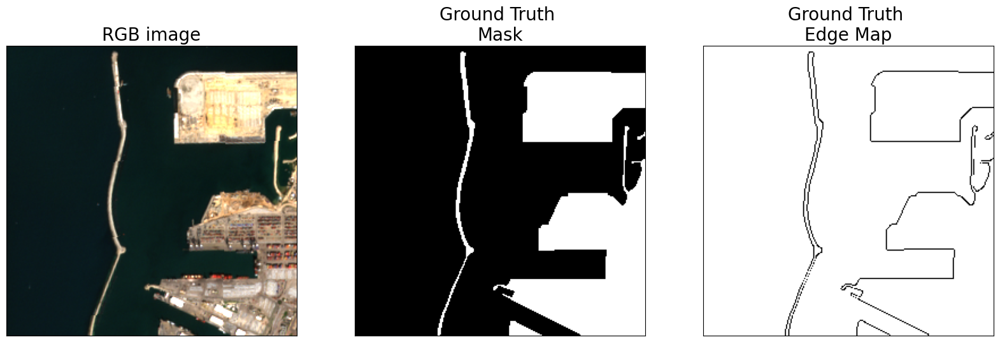

In [12]:
# Sense check
rint = np.random.randint(0, len(edge_reference))
print(rint)
fig, ax = plt.subplots(1, 3, figsize=(20, 20))
fig.set_facecolor('white')

ax[0].imshow(rgb[rint])
ax[0].set_title('RGB image', size=20)
ax[1].imshow(1 - labels[rint], cmap='gray')
ax[1].set_title('Ground Truth \nMask', size=20)
ax[2].imshow(255 - edge_reference[rint], cmap='gray')
ax[2].set_title('Ground Truth \nEdge Map', size=20)

for a in ax:
    a.set_xticks([])
    a.set_yticks([])

plt.savefig(save_path + '\\Figures\\sobel_dataset_example.png', dpi=300, bbox_inches='tight')


In [13]:
# Apply Sobel edge detection with thresholding
def get_sobel(input_images):
    sobel_input = input_images.copy()
    sobel = {}

    for thresh in sobel_thresholds:
        results = []
        for img in sobel_input:
            sobel_img = processor.preprocess(img)  # normalize per band
            out = np.zeros_like(sobel_img)
            for i in range(12):  # 12 bands
                band = sobel_img[:, :, i]
                sobel_band = processor.sobel_ed(band)
                # Apply post-magnitude threshold
                _, binary = cv2.threshold(sobel_band, thresh, 255, cv2.THRESH_BINARY)
                out[:, :, i] = binary
            results.append(out)
        sobel[str(thresh)] = results
        print(f"Threshold {thresh}: {len(results)} images processed.")
    return sobel

sobel = get_sobel(input)

Threshold 50: 98 images processed.
Threshold 100: 98 images processed.
Threshold 150: 98 images processed.
Threshold 200: 98 images processed.
Threshold 250: 98 images processed.
Threshold 300: 98 images processed.


In [14]:
# Evaluate Sobel output using metrics
rows = []

for threshold in sobel_thresholds:
    sobel_output = sobel[str(threshold)]

    for i, output in enumerate(sobel_output):
        ref_img = edge_reference[i]
        ID = i

        for j in range(len(channels)):
            img = output[:, :, j]

            # Evaluation metrics
            rmse_ = rmse(ref_img, img)
            psnr_ = psnr(ref_img, img)
            uqi_ = uqi(ref_img, img)
            ssim_ = ssim(ref_img, img, multichannel=True)
            fom_ = processor.fom(ref_img, img)
            tp_, fp_, tn_, fn_, tpr_, fpr_, tnr_, fnr_, fp_fn_ratio_ = processor.get_rates(ref_img, img)
            pde_ = np.count_nonzero(img) / np.count_nonzero(ref_img)

            row = [ID, threshold, j + 1, rmse_, psnr_, uqi_, ssim_, fom_,
                   tp_, fp_, tn_, fn_, tpr_, fpr_, tnr_, fnr_, fp_fn_ratio_, pde_]
            rows.append(row)

    print(f"Threshold {threshold} done")

# Save to CSV
df_metrics_sobel = pd.DataFrame(rows, columns=[
    'ID', "thresholds", "band", "rmse", "psnr", "uqi", "ssim", "fom",
    "tp", "fp", "tn", "fn", "tpr", "fpr", "tnr", "fnr", "fp_fn_ratio", "pde"
])

df_metrics_sobel.to_csv(save_path + "\\sobel_evaluation_metrics.csv")
df_metrics_sobel.head()

Threshold 50 done
Threshold 100 done
Threshold 150 done
Threshold 200 done
Threshold 250 done
Threshold 300 done


,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde
0,0,50,1,186.130985,2.734430,0.030334,0.001528,0.256608,1523,34010,29096,907,0.626749,0.538934,0.461066,0.373251,37.497244,14.622634
1,0,50,2,240.353934,0.513779,0.022946,0.003020,0.233353,2361,58155,4951,69,0.971605,0.921545,0.078455,0.028395,842.826075,24.903704
2,0,50,3,232.941161,0.785879,0.023390,0.003072,0.241814,2329,54587,8519,101,0.958436,0.865005,0.134995,0.041564,540.465341,23.422222
3,0,50,4,233.540972,0.763542,0.022729,0.002385,0.246321,2371,54911,8195,59,0.975720,0.870139,0.129861,0.024280,930.694899,23.572840
4,0,50,5,229.832309,0.902582,0.022592,0.001518,0.252379,2338,53146,9960,92,0.962140,0.842170,0.157830,0.037860,577.673907,22.832922


Threshold 50: 95 images processed.
Threshold 100: 95 images processed.
Threshold 150: 95 images processed.
Threshold 200: 95 images processed.
Threshold 250: 95 images processed.
Threshold 300: 95 images processed.


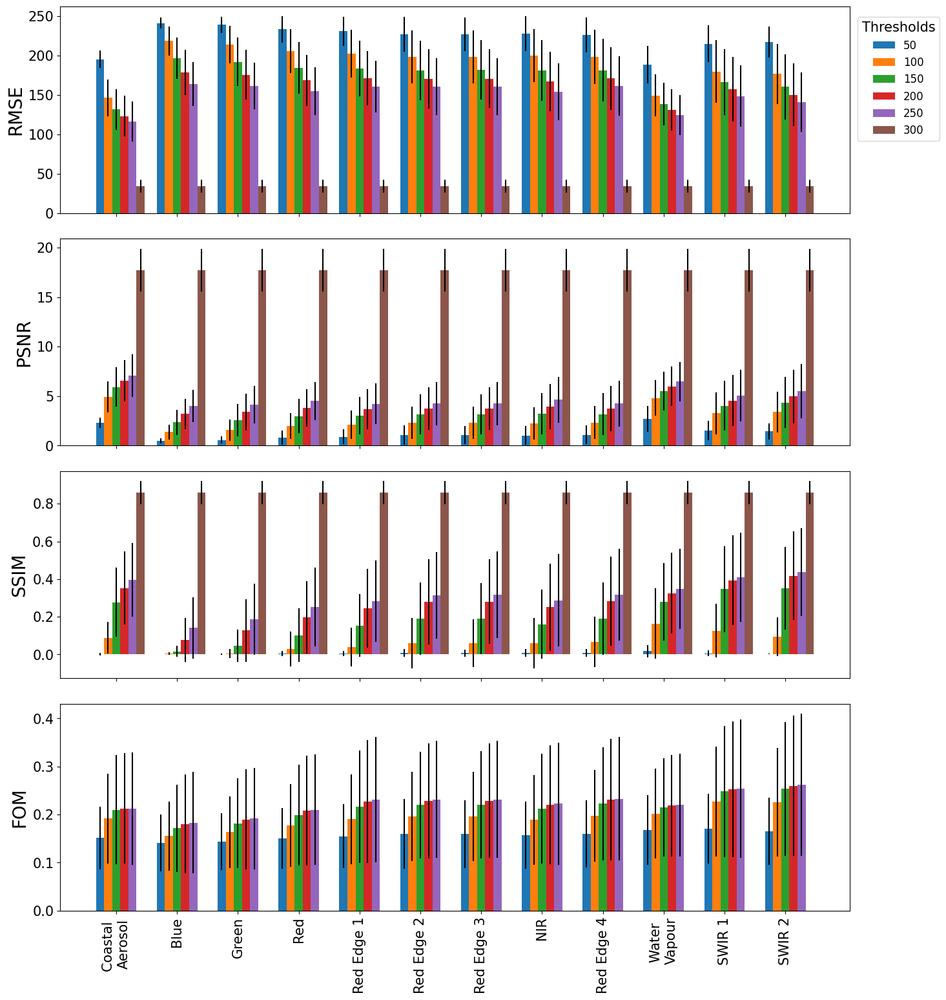

In [15]:
# Load and clean metrics
df_metrics_sobel = pd.read_csv(save_path + "\\sobel_evaluation_metrics.csv")
df_metrics_sobel['fp_fn'] = df_metrics_sobel['fp'] + df_metrics_sobel['fn']

# Drop mislabeled images
df_metrics_sobel_2 = df_metrics_sobel.copy()
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 18].index)
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 41].index)
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 66].index)

# 🔧 Fix: Ensure threshold column is string type
df_metrics_sobel_2['thresholds'] = df_metrics_sobel_2['thresholds'].astype(str)

# Fix thresholds list to string
sobel_thresholds_str = [str(t) for t in sobel_thresholds]

# Recompute inputs/outputs
test_paths_2 = test_path.copy()
path1 = test_paths_2.pop(18)
path2 = test_paths_2.pop(41 - 1)
path3 = test_paths_2.pop(66 - 2)

input_2, rgb_2, labels_2, edge_reference_2 = get_input(test_paths_2)
sobel_2 = get_sobel(input_2)

# Initialize visualizer and plot
viz_sobel = utils.data_visualizer(df_metrics_sobel_2, sobel_2, edge_reference_2, rgb_2, sobel_thresholds_str, channels)
viz_sobel.plot_combined_metric_trends(['rmse', 'psnr', 'ssim', 'fom'],
                                      save_path=save_path + "\\Figures\\sobel_all_metrics.png")


In [16]:
# --- Filter only NIR band (band 7) ---
df_metrics_sobel_nir = df_metrics_sobel_2[df_metrics_sobel_2['band'] == 7]

# --- Mean evaluation metrics per threshold ---
df_mean_sobel = df_metrics_sobel_nir[['thresholds', 'rmse', 'psnr', 'ssim', 'fom']].groupby('thresholds').mean().reset_index()
df_mean_sobel['Threshold'] = df_mean_sobel['thresholds'].astype(int)  # convert string to int for sorting

df_mean_sobel = df_mean_sobel.sort_values(by='Threshold')[['Threshold', 'rmse', 'psnr', 'ssim', 'fom']]
df_mean_sobel.columns = ['Threshold', 'RMSE', 'PSNR', 'SSIM', 'FOM']
df_mean_sobel = df_mean_sobel.round(2)

# --- Copy to clipboard (optional) ---
df_mean_sobel.to_clipboard(index=False)
df_mean_sobel.head()


,Threshold,RMSE,PSNR,SSIM,FOM
5,50,227.06,1.05,0.01,0.16
0,100,198.53,2.31,0.06,0.20
1,150,181.70,3.16,0.19,0.22
2,200,170.72,3.73,0.28,0.23
3,250,160.88,4.25,0.32,0.23


In [17]:
import pandas as pd

# --- Clean image metrics ---
clean_data = {
    'Threshold': [50, 100, 150, 200, 250],
    'RMSE': [117.88, 80.44, 60.11, 48.44, 41.74],
    'PSNR': [7.06, 10.38, 12.88, 14.74, 16.00],
    'SSIM': [0.52, 0.65, 0.74, 0.80, 0.83],
    'FOM': [0.33, 0.41, 0.46, 0.47, 0.38]
}

# --- Noisy image metrics ---
noisy_data = {
    'Threshold': [50, 100, 150, 200, 250],
    'RMSE': [106.13, 79.19, 63.92, 56.56, 52.40],
    'PSNR': [9.13, 11.17, 12.72, 13.63, 14.23],
    'SSIM': [0.54, 0.60, 0.69, 0.76, 0.79],
    'FOM': [0.16, 0.23, 0.30, 0.34, 0.36]
}

# --- Convert to DataFrames ---
df_clean = pd.DataFrame(clean_data)
df_noisy = pd.DataFrame(noisy_data)

# --- Calculate percentage change ((noisy - clean)/clean * 100) ---
percent_change = pd.DataFrame()
percent_change['Threshold'] = df_clean['Threshold']

for metric in ['RMSE', 'PSNR', 'SSIM', 'FOM']:
    percent_change[f'{metric}_Change_%'] = (
        (df_noisy[metric] - df_clean[metric]) / df_clean[metric] * 100
    ).round(2)

# --- Display Result ---
print("Percentage Change in Metrics (Noisy vs Clean):")
print(percent_change)


Percentage Change in Metrics (Noisy vs Clean):
   Threshold  RMSE_Change_%  PSNR_Change_%  SSIM_Change_%  FOM_Change_%
0         50          -9.97          29.32           3.85        -51.52
1        100          -1.55           7.61          -7.69        -43.90
2        150           6.34          -1.24          -6.76        -34.78
3        200          16.76          -7.53          -5.00        -27.66
4        250          25.54         -11.06          -4.82         -5.26


In [18]:
# --- Initialize count dataframe with threshold values ---
best_threshold_count_sobel = pd.DataFrame({'Threshold': sobel_thresholds})

for metric in ['rmse', 'psnr', 'ssim', 'fom']:
    df = df_metrics_sobel_2[['ID', 'thresholds', metric]]

    # Select best threshold per image
    if metric == 'rmse':
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmin()]
    else:
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmax()]

    # Count occurrences of each threshold
    count = []
    print(f"\nBest thresholds for {metric.upper()}:")
    for threshold in sobel_thresholds:
        df_thresh = best_thresholds[best_thresholds['thresholds'] == str(threshold)]
        count.append(len(df_thresh))
        print(f"Threshold {threshold}: {len(df_thresh)} occurrences")

    best_threshold_count_sobel[metric.upper()] = count

# --- Copy to clipboard (optional) ---
best_threshold_count_sobel.to_clipboard(index=False)
best_threshold_count_sobel



Best thresholds for RMSE:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 0 occurrences
Threshold 200: 0 occurrences
Threshold 250: 0 occurrences
Threshold 300: 95 occurrences

Best thresholds for PSNR:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 0 occurrences
Threshold 200: 0 occurrences
Threshold 250: 0 occurrences
Threshold 300: 95 occurrences

Best thresholds for SSIM:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 0 occurrences
Threshold 200: 0 occurrences
Threshold 250: 0 occurrences
Threshold 300: 95 occurrences

Best thresholds for FOM:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 5 occurrences
Threshold 200: 3 occurrences
Threshold 250: 87 occurrences
Threshold 300: 0 occurrences


,Threshold,RMSE,PSNR,SSIM,FOM
0,50,0,0,0,0
1,100,0,0,0,0
2,150,0,0,0,5
3,200,0,0,0,3
4,250,0,0,0,87
5,300,95,95,95,0


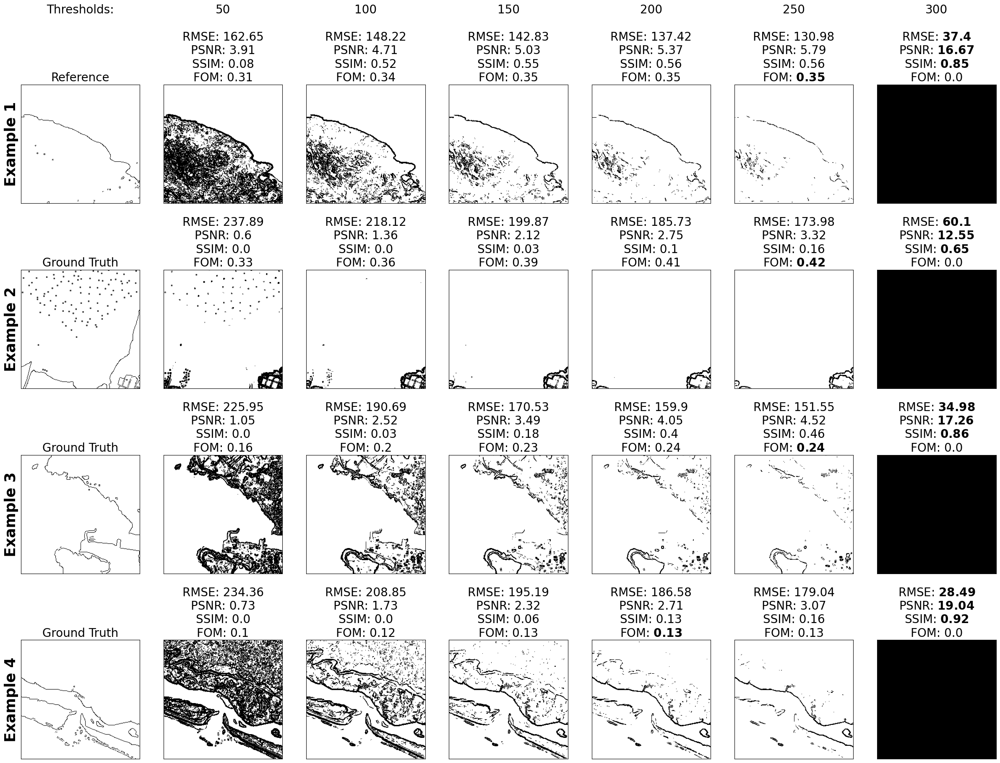

In [19]:
# --- Convert 'thresholds' column to string for matching ---
df_metrics_sobel_2["thresholds"] = df_metrics_sobel_2["thresholds"].astype(str)

# --- Select image IDs where FOM behaves meaningfully ---
IDs = [74, 40, 2, 68]

# --- Plot and save Sobel edge examples using the sobel visualizer ---
viz_sobel.example_plots(IDs, save_path=save_path + "\\Figures\\sobel_good_examples.png")


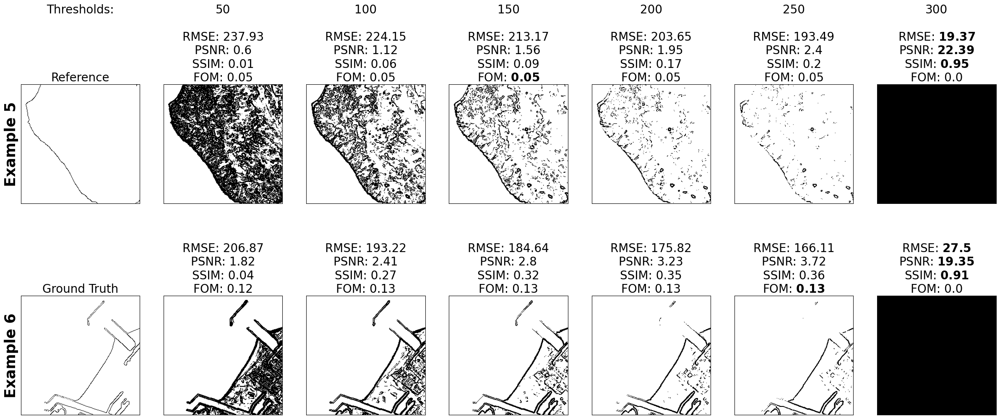

In [20]:
# Examples of results where FOM does not identify the best threshold
IDs = [15,32]
viz_sobel.example_plots(IDs,ex_diff=4,save_path=save_path+"\\Figures\\bad_examples.png")

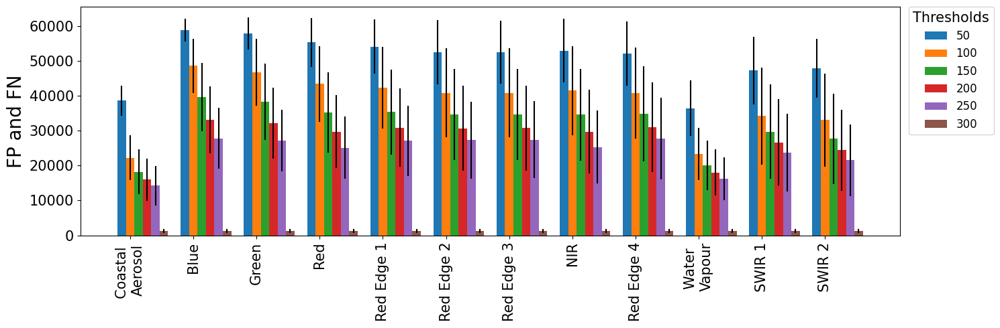

In [21]:
# --- Sum FP and FN across all thresholds ---
viz_sobel.plot_metric_trends('fp_fn', ylabel="FP and FN", save_path=save_path + "\\Figures\\sobel_fp_fn_sum.png")


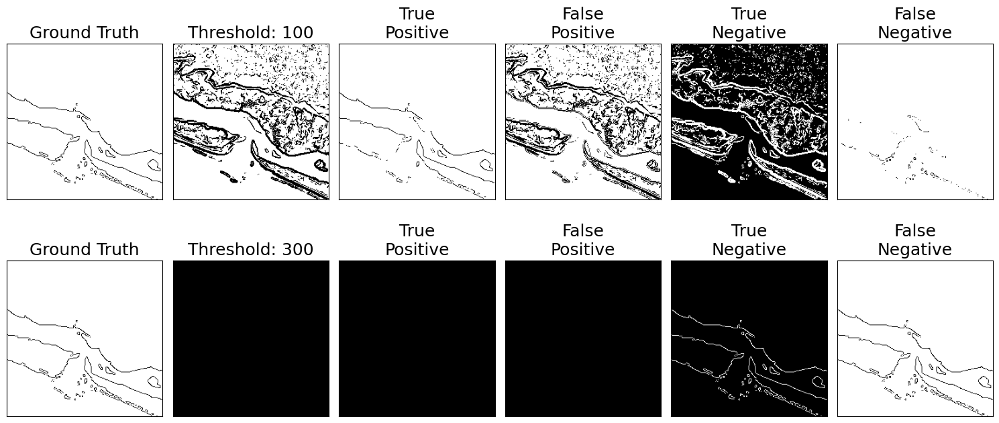

In [22]:
# --- TP/FP/TN/FN visual example for Sobel ---
rint = 68
band = 7
thresholds_to_plot = [100, 300]  # Single-value Sobel thresholds

fig, axs = plt.subplots(2, 6, figsize=(15, 7))
fig.set_facecolor('white')

for i, threshold in enumerate(thresholds_to_plot):
    reference = edge_reference_2[rint].astype(float)
    detected = sobel_2[str(threshold)][rint][:, :, band].astype(float)

    # True Positive
    TP = reference - (255 - detected)
    TP[TP < 0] = 0

    # False Positive
    FP = detected - TP

    # True Negative
    TN = (255 - reference) - detected
    TN[TN < 0] = 0

    # False Negative
    FN = (255 - detected) - (255 - reference)
    FN[FN < 0] = 0

    # --- Plotting ---
    axs[i, 0].imshow(255 - reference, cmap="gray")
    axs[i, 0].set_title("Ground Truth", size=18)

    axs[i, 1].imshow(255 - detected, cmap="gray")
    axs[i, 1].set_title(f"Threshold: {threshold}", size=18)

    axs[i, 2].imshow(255 - TP, cmap="gray")
    axs[i, 2].set_title("True\nPositive", size=18)

    axs[i, 3].imshow(255 - FP, cmap="gray")
    axs[i, 3].set_title("False\nPositive", size=18)

    axs[i, 4].imshow(255 - TN, cmap="gray")
    axs[i, 4].set_title("True\nNegative", size=18)

    axs[i, 5].imshow(255 - FN, cmap="gray")
    axs[i, 5].set_title("False\nNegative", size=18)

for ax in axs.flat:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path + "\\Figures\\sobel_TP_FP_example.png", dpi=300)

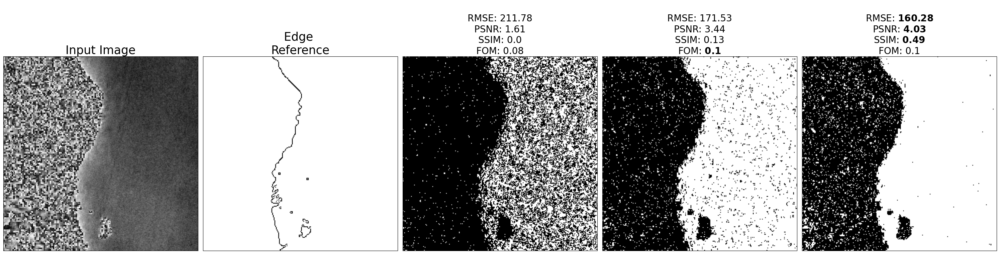

In [23]:
import importlib
importlib.reload(utils)  # Reload updated utils.py

fig, axs = plt.subplots(1, 5, figsize=(30, 20))
fig.set_facecolor('white')

rint = 67  # Image index
thresholds = [50, 100, 150]  # Sobel thresholds (single values)
band = 10

img_input = input[rint].copy()

# Plot original input band
axs[0].imshow(img_input[:, :, band], cmap="gray")
axs[0].set_title("Input Image", size=25)

# Plot ground truth edge reference
ref_img = edge_reference[rint]
axs[1].imshow(255 - ref_img, cmap="gray")
axs[1].set_title("Edge \nReference", size=25)

# Processor instance
processor = utils.data_processor()

# Preprocess band for Sobel
sobel_input = processor.preprocess(img_input)
band_img = sobel_input[:, :, band]

# Loop through Sobel thresholds
for i, t in enumerate(thresholds):
    sobel_band = processor.sobel_ed(band_img)
    _, binary_img = cv2.threshold(sobel_band, t, 255, cv2.THRESH_BINARY)

    axs[i + 2].imshow(255 - binary_img, cmap="gray")

    # Compute metrics
    rmse_ = round(rmse(ref_img, binary_img), 2)
    psnr_ = round(psnr(ref_img, binary_img), 2)
    ssim_ = round(ssim(ref_img, binary_img, multichannel=True), 2)
    fom_ = round(processor.fom(ref_img, binary_img), 2)

    # Dynamic metric title formatting (bold best if needed)
    if i == 0:
        axs[i + 2].set_title(f"\nRMSE: {rmse_}\nPSNR: {psnr_}\nSSIM: {ssim_}\nFOM: {fom_}", size=20)
    elif i == 1:
        axs[i + 2].set_title(f"\nRMSE: {rmse_}\nPSNR: {psnr_}\nSSIM: {ssim_}\nFOM: " + r"$\bf{" + str(fom_) + "}$", size=20)
    else:
        axs[i + 2].set_title(
            "\nRMSE: " + r"$\bf{" + str(rmse_) + "}$" +
            "\nPSNR: " + r"$\bf{" + str(psnr_) + "}$" +
            "\nSSIM: " + r"$\bf{" + str(ssim_) + "}$" +
            "\nFOM: " + str(fom_), size=20
        )

# Remove ticks
for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path + "\\Figures\\sobel_threshold_comparison.png", dpi=300)
plt.show()


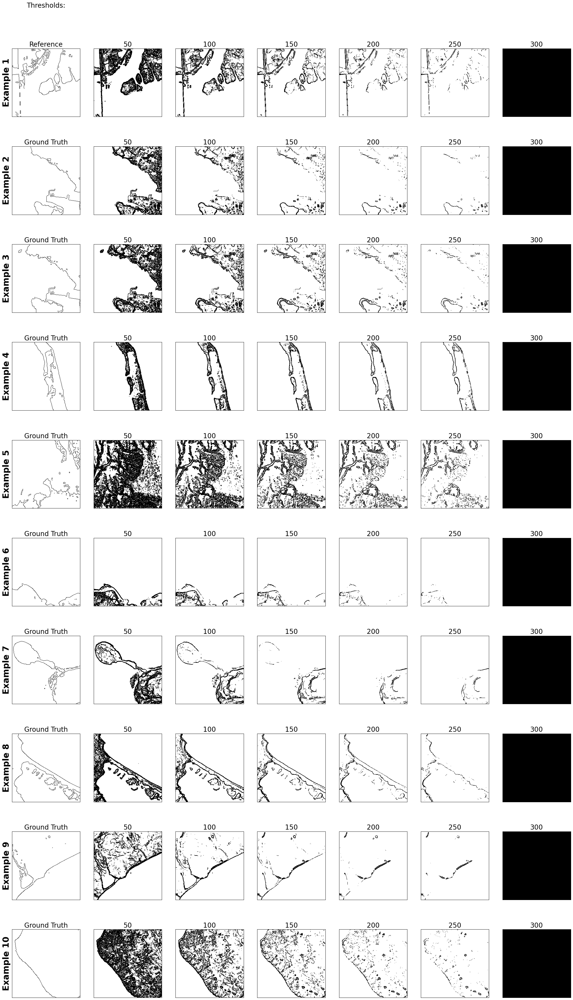

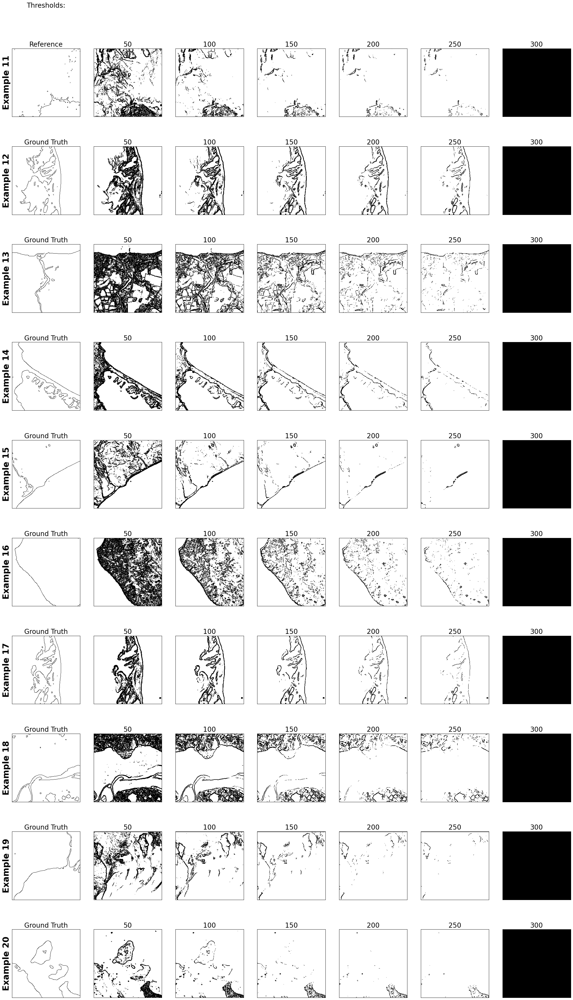

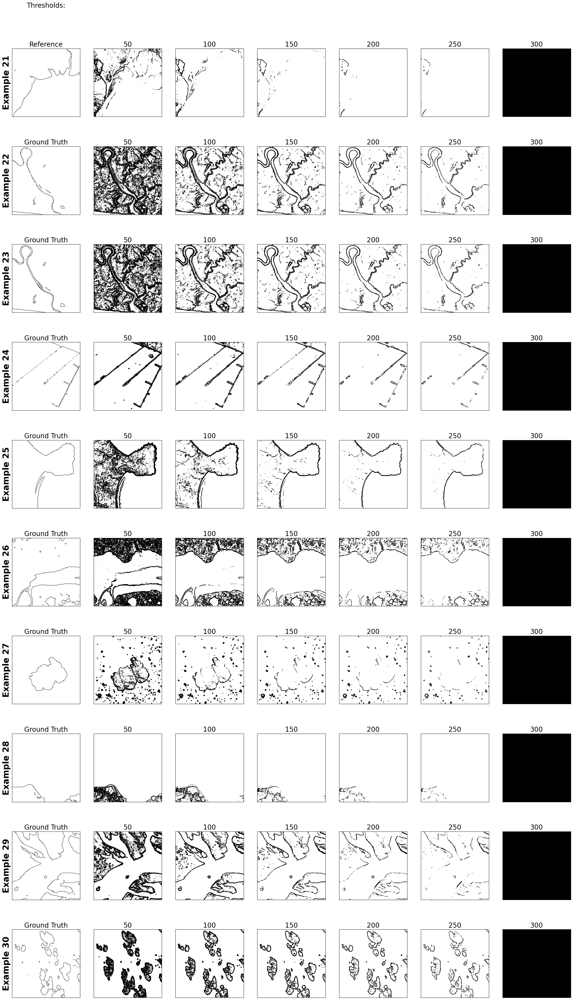

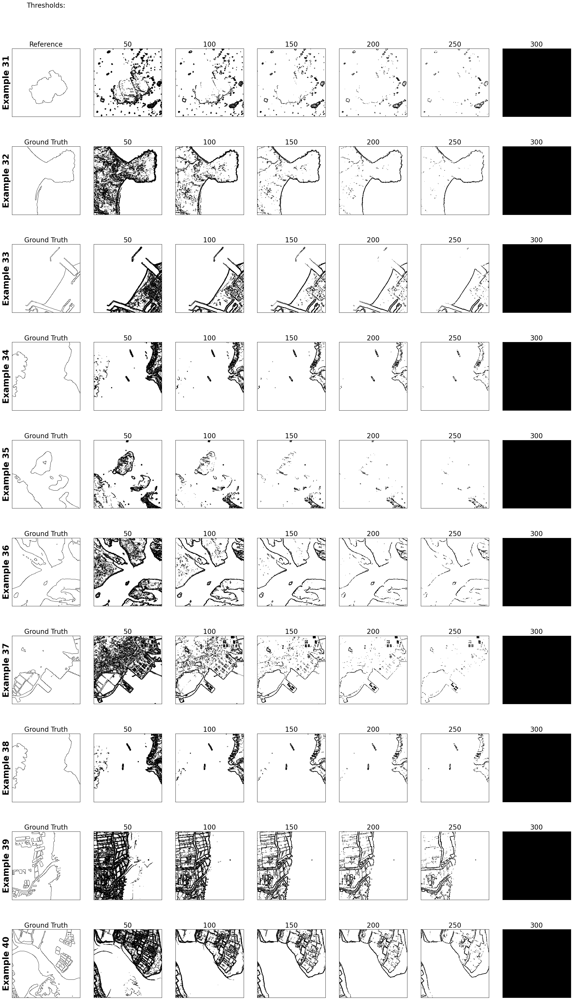

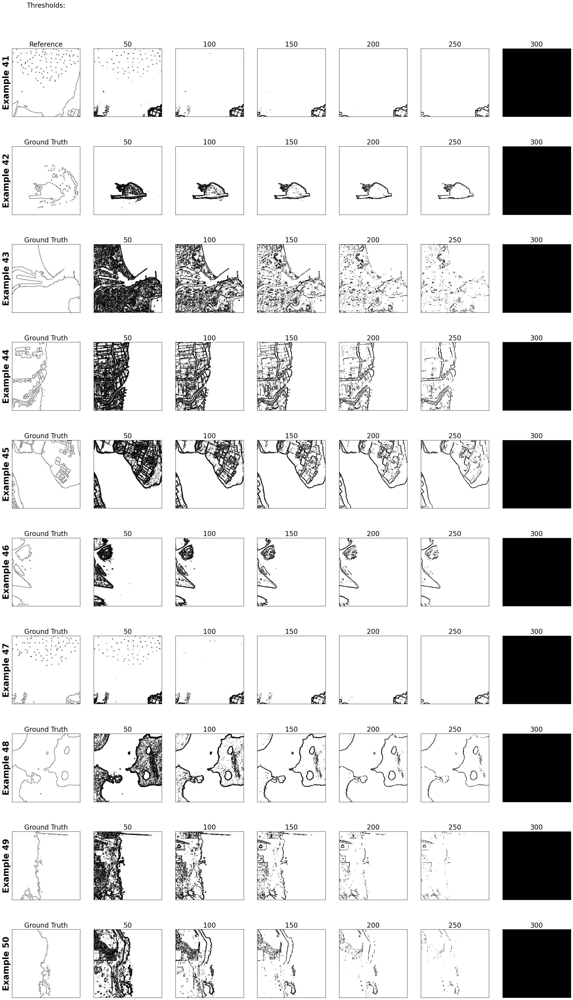

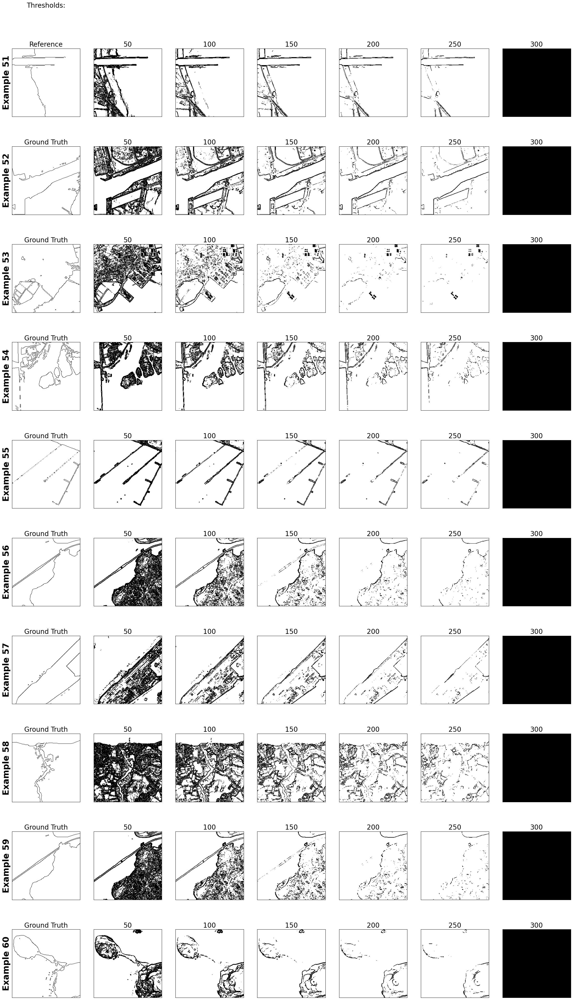

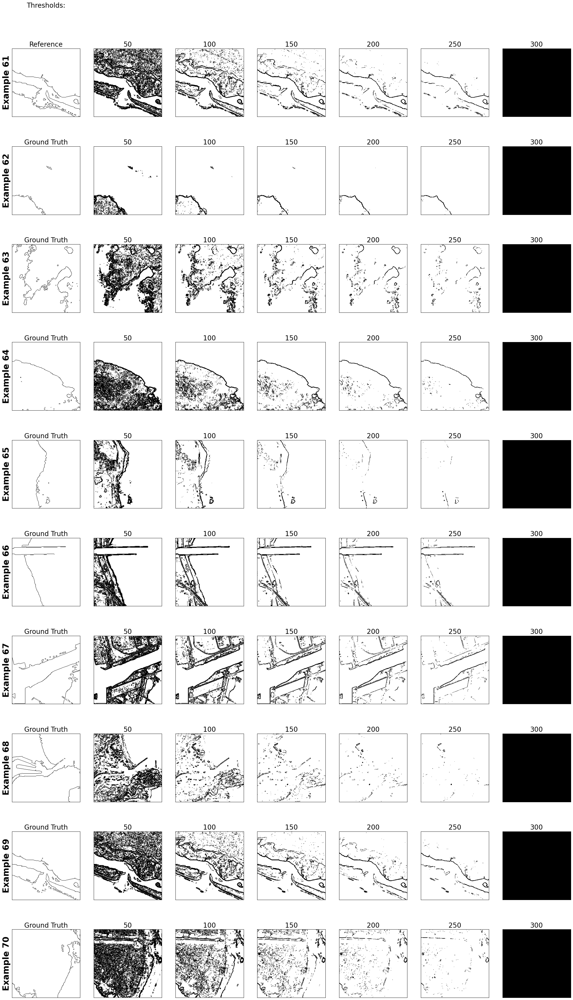

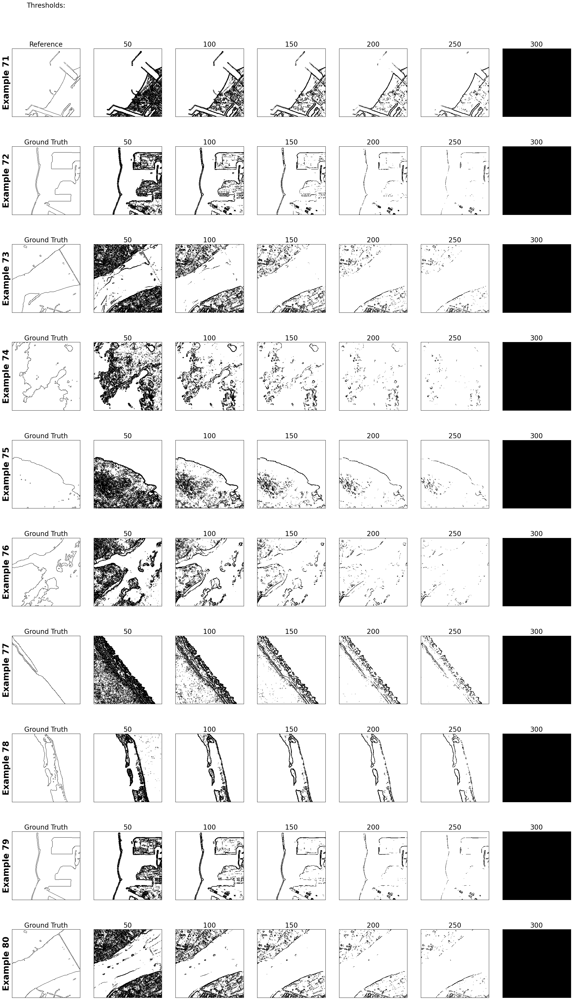

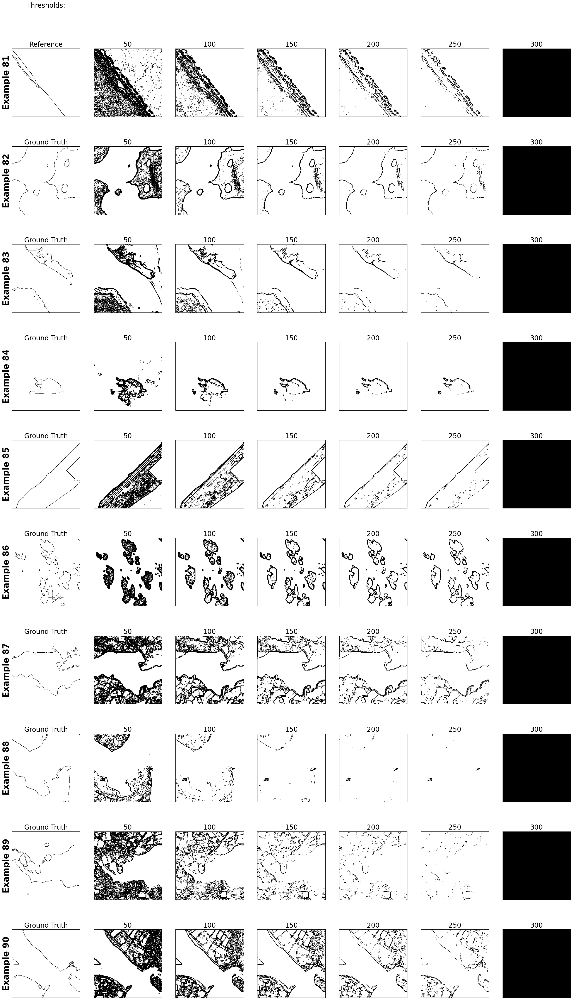

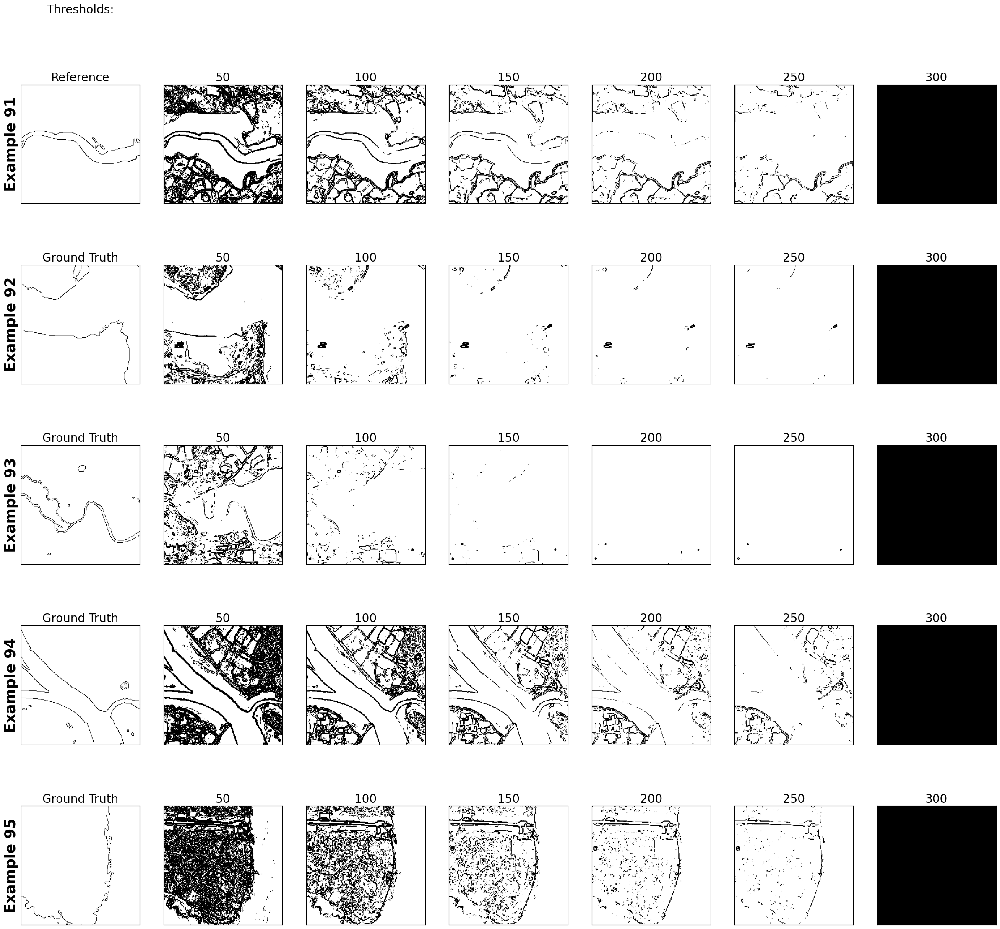

In [24]:
# --- Get image names for visual inspection ---
x = [path.split("/")[-1] for path in test_path]
df = pd.DataFrame({"ID": x})
df.to_clipboard(index=False) 

# Recalculate ALL_IDS based on actual filtered dataset size
num_images = len(test_paths_2)  # Should be 95 after removing 3
group_size = 10

ALL_IDS = [list(range(i, min(i + group_size, num_images))) for i in range(0, num_images, group_size)]
for i, IDs in enumerate(ALL_IDS):
    viz_sobel.example_plots(IDs, ex_diff=10 * i, show_metrics=False,
                          save_path=save_path + f"\\Figures\\prewitt_group_{i+1}.png") 

In [25]:
# Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import cv2
import glob
from skimage.metrics import structural_similarity as ssim
from sewar.full_ref import rmse, psnr, uqi

# Import helper functions from utils.py
import utils
import importlib
importlib.reload(utils)

# Save path
save_path = r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\Evaluation metrics"

# Global variables
channels = ['Coastal \nAerosol','Blue','Green',
            'Red','Red Edge 1','Red Edge 2',
            'Red Edge 3','NIR','Red Edge 4',
            'Water \nVapour','SWIR 1','SWIR 2']

# Sobel thresholds (single-value gradient magnitude)
sobel_thresholds = [50, 100, 150, 200, 250, 300]

In [26]:
# Test image paths
test_path = glob.glob(r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\*")
print(test_path[0])
print(len(test_path))

E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190312T031541_N0211_R118_T48QYJ_20190312T083550_image_0_0.tif
98


In [27]:
# Initialise processor
processor = utils.data_processor()

In [28]:
# Load input data
def get_input(paths):
    input = []
    rgb = []
    labels = []

    for path in paths:
        try:
            img, rgb_img, label = processor.load_test(path)
            input.append(img)
            labels.append(label)
            rgb.append(rgb_img)
        except:
            print("Error with image: ", path)

    # Convert binary label to edge reference using Canny (as fixed ground truth edge)
    canny_input = [np.uint8(img * 255) for img in labels]
    edge_reference = [np.uint8(cv2.Canny(img, threshold1=100, threshold2=200)) for img in canny_input]

    return input, rgb, labels, edge_reference

input, rgb, labels, edge_reference = get_input(test_path)

80


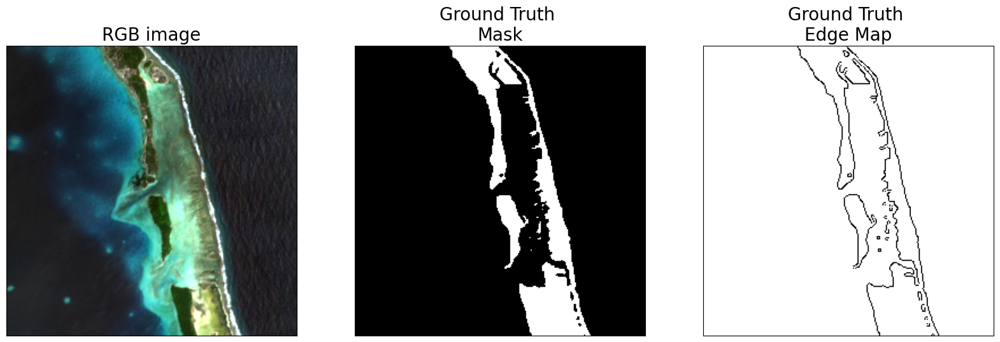

In [29]:
# Sense check
rint = np.random.randint(0, len(edge_reference))
print(rint)
fig, ax = plt.subplots(1, 3, figsize=(20, 20))
fig.set_facecolor('white')

ax[0].imshow(rgb[rint])
ax[0].set_title('RGB image', size=20)
ax[1].imshow(1 - labels[rint], cmap='gray')
ax[1].set_title('Ground Truth \nMask', size=20)
ax[2].imshow(255 - edge_reference[rint], cmap='gray')
ax[2].set_title('Ground Truth \nEdge Map', size=20)

for a in ax:
    a.set_xticks([])
    a.set_yticks([])

plt.savefig(save_path + '\\Figures\\sobel_dataset_example.png', dpi=300, bbox_inches='tight')

In [30]:
# Apply Sobel edge detection with thresholding AFTER Gaussian blur
def get_sobel(input_images):
    sobel_input = input_images.copy()
    sobel = {}

    for thresh in sobel_thresholds:
        results = []
        for img in sobel_input:
            sobel_img = processor.preprocess(img)  # Normalize per band
            out = np.zeros_like(sobel_img)

            for i in range(12):  # 12 spectral bands
                band = sobel_img[:, :, i]

                # 🔹 Apply Gaussian Blur before Sobel (kernel size 3x3)
                blurred_band = cv2.GaussianBlur(band, (3, 3), 0)

                # 🔹 Apply Sobel
                sobel_band = processor.sobel_ed(blurred_band)

                # 🔹 Apply magnitude threshold
                _, binary = cv2.threshold(sobel_band, thresh, 255, cv2.THRESH_BINARY)

                out[:, :, i] = binary

            results.append(out)
        sobel[str(thresh)] = results
        print(f"[Blurred] Threshold {thresh}: {len(results)} images processed.")

    return sobel

sobel = get_sobel(input)

[Blurred] Threshold 50: 98 images processed.
[Blurred] Threshold 100: 98 images processed.
[Blurred] Threshold 150: 98 images processed.
[Blurred] Threshold 200: 98 images processed.
[Blurred] Threshold 250: 98 images processed.
[Blurred] Threshold 300: 98 images processed.


In [31]:
# Evaluate Sobel output using metrics
rows = []

for threshold in sobel_thresholds:
    sobel_output = sobel[str(threshold)]

    for i, output in enumerate(sobel_output):
        ref_img = edge_reference[i]
        ID = i

        for j in range(len(channels)):
            img = output[:, :, j]

            # Evaluation metrics
            rmse_ = rmse(ref_img, img)
            psnr_ = psnr(ref_img, img)
            uqi_ = uqi(ref_img, img)
            ssim_ = ssim(ref_img, img, multichannel=True)
            fom_ = processor.fom(ref_img, img)
            tp_, fp_, tn_, fn_, tpr_, fpr_, tnr_, fnr_, fp_fn_ratio_ = processor.get_rates(ref_img, img)
            pde_ = np.count_nonzero(img) / np.count_nonzero(ref_img)

            row = [ID, threshold, j + 1, rmse_, psnr_, uqi_, ssim_, fom_,
                   tp_, fp_, tn_, fn_, tpr_, fpr_, tnr_, fnr_, fp_fn_ratio_, pde_]
            rows.append(row)

    print(f"Threshold {threshold} done")

# Save to CSV
df_metrics_sobel = pd.DataFrame(rows, columns=[
    'ID', "thresholds", "band", "rmse", "psnr", "uqi", "ssim", "fom",
    "tp", "fp", "tn", "fn", "tpr", "fpr", "tnr", "fnr", "fp_fn_ratio", "pde"
])

df_metrics_sobel.to_csv(save_path + "\\sobel_evaluation_metrics.csv")
df_metrics_sobel.head()

Threshold 50 done
Threshold 100 done
Threshold 150 done
Threshold 200 done
Threshold 250 done
Threshold 300 done


,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde
0,0,50,1,77.291997,10.368113,0.640176,0.651874,0.502864,452,4043,59063,1978,0.186008,0.064067,0.935933,0.813992,2.043984,1.849794
1,0,50,2,74.414270,10.697679,0.664988,0.680132,0.515638,552,3703,59403,1878,0.227160,0.058679,0.941321,0.772840,1.971778,1.751029
2,0,50,3,78.185428,10.268287,0.664742,0.677506,0.500063,623,4354,58752,1807,0.256379,0.068995,0.931005,0.743621,2.409519,2.048148
3,0,50,4,85.837624,9.457250,0.643567,0.651812,0.504628,933,5929,57177,1497,0.383951,0.093953,0.906047,0.616049,3.960588,2.823868
4,0,50,5,86.166428,9.424042,0.659705,0.668660,0.550164,1015,6068,57038,1415,0.417695,0.096156,0.903844,0.582305,4.288339,2.914815


[Blurred] Threshold 50: 95 images processed.
[Blurred] Threshold 100: 95 images processed.
[Blurred] Threshold 150: 95 images processed.
[Blurred] Threshold 200: 95 images processed.
[Blurred] Threshold 250: 95 images processed.
[Blurred] Threshold 300: 95 images processed.


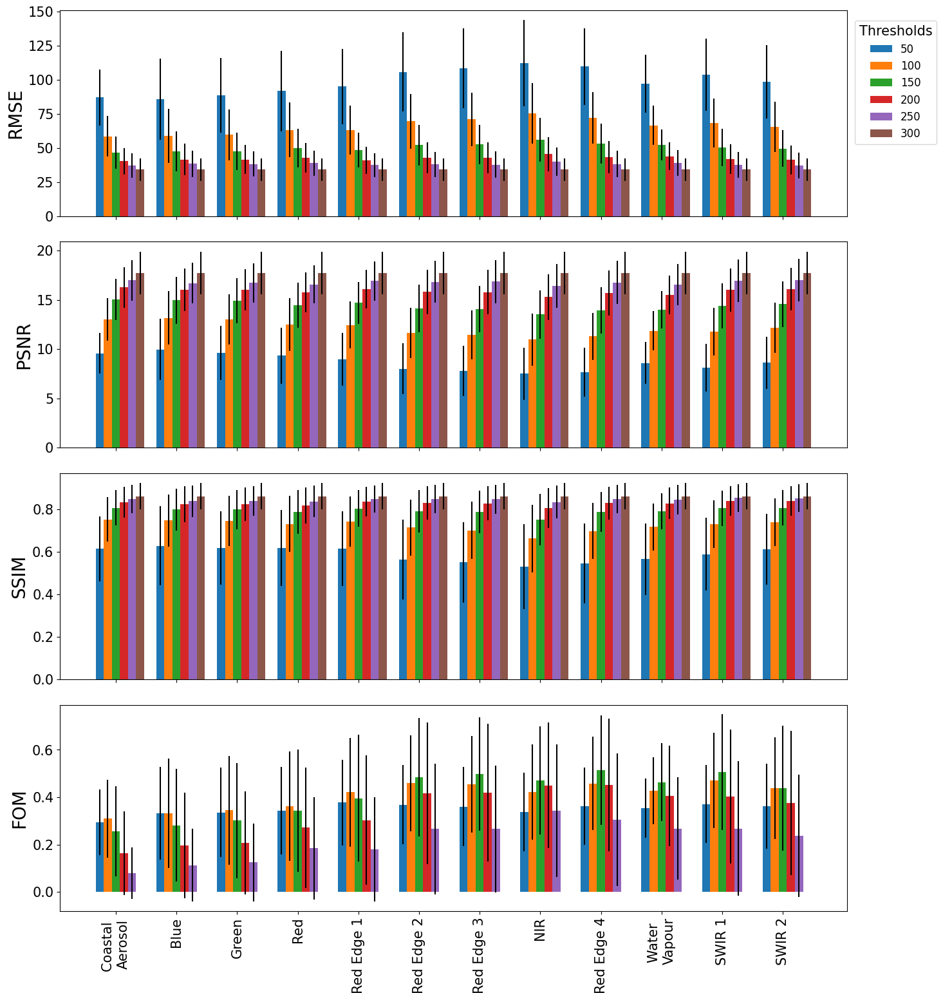

In [32]:
# Load and clean metrics
df_metrics_sobel = pd.read_csv(save_path + "\\sobel_evaluation_metrics.csv")
df_metrics_sobel['fp_fn'] = df_metrics_sobel['fp'] + df_metrics_sobel['fn']

# Drop mislabeled images
df_metrics_sobel_2 = df_metrics_sobel.copy()
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 18].index)
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 41].index)
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 66].index)

# 🔧 Fix: Ensure threshold column is string type
df_metrics_sobel_2['thresholds'] = df_metrics_sobel_2['thresholds'].astype(str)

# Fix thresholds list to string
sobel_thresholds_str = [str(t) for t in sobel_thresholds]

# Recompute inputs/outputs
test_paths_2 = test_path.copy()
path1 = test_paths_2.pop(18)
path2 = test_paths_2.pop(41 - 1)
path3 = test_paths_2.pop(66 - 2)

input_2, rgb_2, labels_2, edge_reference_2 = get_input(test_paths_2)
sobel_2 = get_sobel(input_2)

# Initialize visualizer and plot
viz_sobel = utils.data_visualizer(df_metrics_sobel_2, sobel_2, edge_reference_2, rgb_2, sobel_thresholds_str, channels)
viz_sobel.plot_combined_metric_trends(['rmse', 'psnr', 'ssim', 'fom'],
                                      save_path=save_path + "\\Figures\\sobel_all_metrics.png")

In [33]:
# --- Filter only NIR band (band 7) ---
df_metrics_sobel_nir = df_metrics_sobel_2[df_metrics_sobel_2['band'] == 7]

# --- Mean evaluation metrics per threshold ---
df_mean_sobel = df_metrics_sobel_nir[['thresholds', 'rmse', 'psnr', 'ssim', 'fom']].groupby('thresholds').mean().reset_index()
df_mean_sobel['Threshold'] = df_mean_sobel['thresholds'].astype(int)  # convert string to int for sorting

df_mean_sobel = df_mean_sobel.sort_values(by='Threshold')[['Threshold', 'rmse', 'psnr', 'ssim', 'fom']]
df_mean_sobel.columns = ['Threshold', 'RMSE', 'PSNR', 'SSIM', 'FOM']
df_mean_sobel = df_mean_sobel.round(2)

# --- Copy to clipboard (optional) ---
df_mean_sobel.to_clipboard(index=False)
df_mean_sobel.head()


,Threshold,RMSE,PSNR,SSIM,FOM
5,50,108.42,7.77,0.55,0.36
0,100,71.03,11.44,0.70,0.45
1,150,52.48,14.05,0.79,0.50
2,200,42.84,15.79,0.83,0.42
3,250,37.82,16.84,0.85,0.27


In [34]:
# --- Initialize count dataframe with threshold values ---
best_threshold_count_sobel = pd.DataFrame({'Threshold': sobel_thresholds})

for metric in ['rmse', 'psnr', 'ssim', 'fom']:
    df = df_metrics_sobel_2[['ID', 'thresholds', metric]]

    # Select best threshold per image
    if metric == 'rmse':
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmin()]
    else:
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmax()]

    # Count occurrences of each threshold
    count = []
    print(f"\nBest thresholds for {metric.upper()}:")
    for threshold in sobel_thresholds:
        df_thresh = best_thresholds[best_thresholds['thresholds'] == str(threshold)]
        count.append(len(df_thresh))
        print(f"Threshold {threshold}: {len(df_thresh)} occurrences")

    best_threshold_count_sobel[metric.upper()] = count

# --- Copy to clipboard (optional) ---
best_threshold_count_sobel.to_clipboard(index=False)
best_threshold_count_sobel



Best thresholds for RMSE:
Threshold 50: 0 occurrences
Threshold 100: 1 occurrences
Threshold 150: 1 occurrences
Threshold 200: 0 occurrences
Threshold 250: 5 occurrences
Threshold 300: 88 occurrences

Best thresholds for PSNR:
Threshold 50: 0 occurrences
Threshold 100: 1 occurrences
Threshold 150: 1 occurrences
Threshold 200: 0 occurrences
Threshold 250: 5 occurrences
Threshold 300: 88 occurrences

Best thresholds for SSIM:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 6 occurrences
Threshold 200: 9 occurrences
Threshold 250: 36 occurrences
Threshold 300: 44 occurrences

Best thresholds for FOM:
Threshold 50: 7 occurrences
Threshold 100: 8 occurrences
Threshold 150: 24 occurrences
Threshold 200: 39 occurrences
Threshold 250: 17 occurrences
Threshold 300: 0 occurrences


,Threshold,RMSE,PSNR,SSIM,FOM
0,50,0,0,0,7
1,100,1,1,0,8
2,150,1,1,6,24
3,200,0,0,9,39
4,250,5,5,36,17
5,300,88,88,44,0


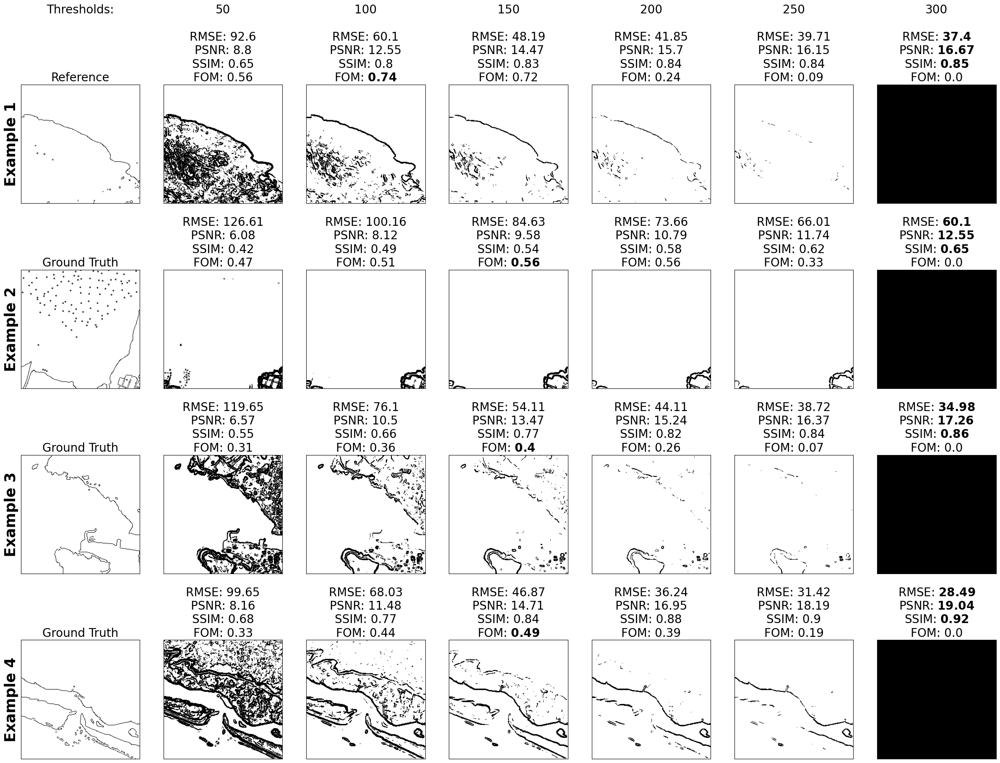

In [35]:
# --- Convert 'thresholds' column to string for matching ---
df_metrics_sobel_2["thresholds"] = df_metrics_sobel_2["thresholds"].astype(str)

# --- Select image IDs where FOM behaves meaningfully ---
IDs = [74, 40, 2, 68]

# --- Plot and save Sobel edge examples using the sobel visualizer ---
viz_sobel.example_plots(IDs, save_path=save_path + "\\Figures\\sobel_good_examples.png")

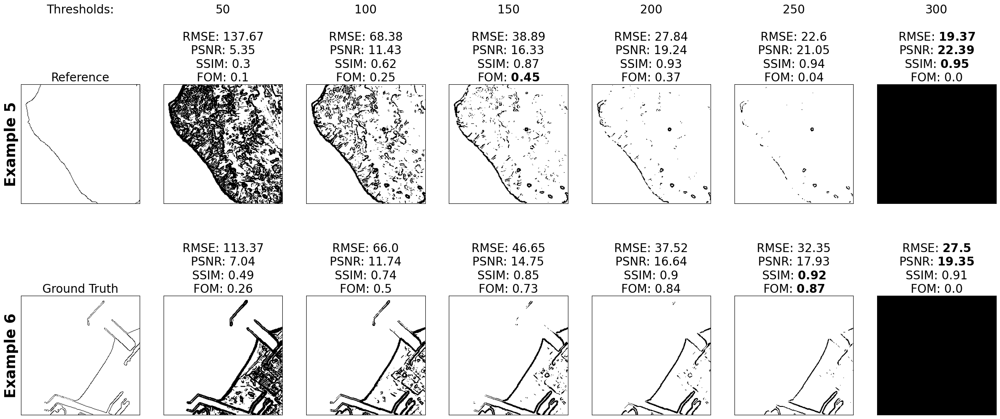

In [36]:
# Examples of results where FOM does not identify the best threshold
IDs = [15,32]
viz_sobel.example_plots(IDs,ex_diff=4,save_path=save_path+"\\Figures\\bad_examples.png")

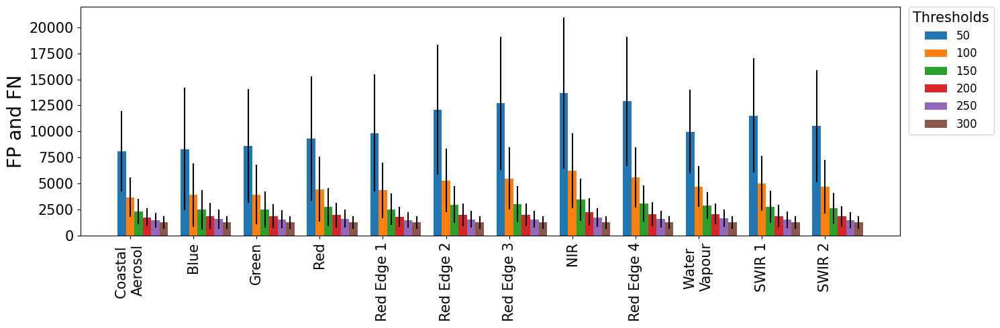

In [37]:
# --- Sum FP and FN across all thresholds ---
viz_sobel.plot_metric_trends('fp_fn', ylabel="FP and FN", save_path=save_path + "\\Figures\\sobel_fp_fn_sum.png")

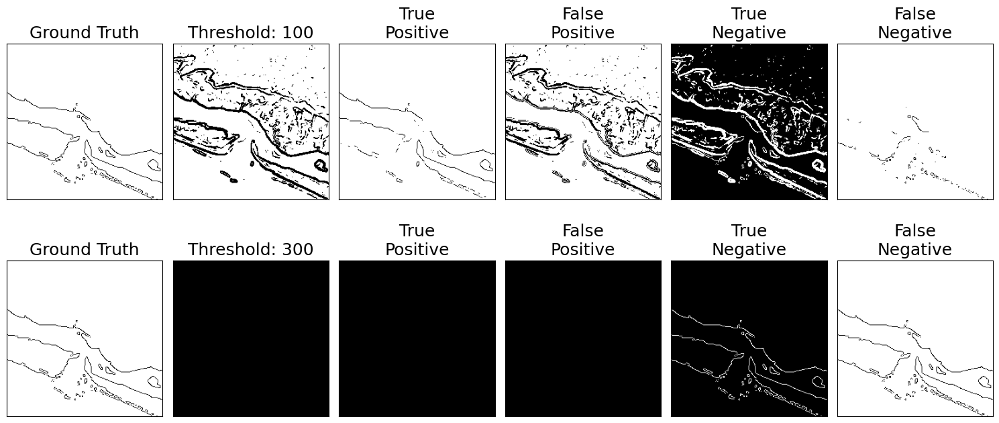

In [38]:
# --- TP/FP/TN/FN visual example for Sobel ---
rint = 68
band = 7
thresholds_to_plot = [100, 300]  # Single-value Sobel thresholds

fig, axs = plt.subplots(2, 6, figsize=(15, 7))
fig.set_facecolor('white')

for i, threshold in enumerate(thresholds_to_plot):
    reference = edge_reference_2[rint].astype(float)
    detected = sobel_2[str(threshold)][rint][:, :, band].astype(float)

    # True Positive
    TP = reference - (255 - detected)
    TP[TP < 0] = 0

    # False Positive
    FP = detected - TP

    # True Negative
    TN = (255 - reference) - detected
    TN[TN < 0] = 0

    # False Negative
    FN = (255 - detected) - (255 - reference)
    FN[FN < 0] = 0

    # --- Plotting ---
    axs[i, 0].imshow(255 - reference, cmap="gray")
    axs[i, 0].set_title("Ground Truth", size=18)

    axs[i, 1].imshow(255 - detected, cmap="gray")
    axs[i, 1].set_title(f"Threshold: {threshold}", size=18)

    axs[i, 2].imshow(255 - TP, cmap="gray")
    axs[i, 2].set_title("True\nPositive", size=18)

    axs[i, 3].imshow(255 - FP, cmap="gray")
    axs[i, 3].set_title("False\nPositive", size=18)

    axs[i, 4].imshow(255 - TN, cmap="gray")
    axs[i, 4].set_title("True\nNegative", size=18)

    axs[i, 5].imshow(255 - FN, cmap="gray")
    axs[i, 5].set_title("False\nNegative", size=18)

for ax in axs.flat:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path + "\\Figures\\sobel_TP_FP_example.png", dpi=300)

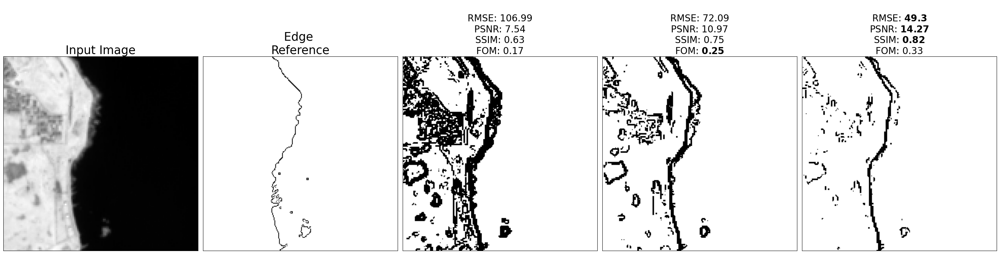

In [39]:
import importlib
importlib.reload(utils)  # Reload updated utils.py

fig, axs = plt.subplots(1, 5, figsize=(30, 20))
fig.set_facecolor('white')

rint = 67  # Image index
thresholds = [50, 100, 150]  # Sobel thresholds (single values)
band = 10

img_input = input[rint].copy()

# Plot original input band
axs[0].imshow(img_input[:, :, band], cmap="gray")
axs[0].set_title("Input Image", size=25)

# Plot ground truth edge reference
ref_img = edge_reference[rint]
axs[1].imshow(255 - ref_img, cmap="gray")
axs[1].set_title("Edge \nReference", size=25)

# Processor instance
processor = utils.data_processor()

# Preprocess band for Sobel
sobel_input = processor.preprocess(img_input)
band_img = sobel_input[:, :, band]

# Loop through Sobel thresholds
for i, t in enumerate(thresholds):
    sobel_band = processor.sobel_ed(band_img)
    _, binary_img = cv2.threshold(sobel_band, t, 255, cv2.THRESH_BINARY)

    axs[i + 2].imshow(255 - binary_img, cmap="gray")

    # Compute metrics
    rmse_ = round(rmse(ref_img, binary_img), 2)
    psnr_ = round(psnr(ref_img, binary_img), 2)
    ssim_ = round(ssim(ref_img, binary_img, multichannel=True), 2)
    fom_ = round(processor.fom(ref_img, binary_img), 2)

    # Dynamic metric title formatting (bold best if needed)
    if i == 0:
        axs[i + 2].set_title(f"\nRMSE: {rmse_}\nPSNR: {psnr_}\nSSIM: {ssim_}\nFOM: {fom_}", size=20)
    elif i == 1:
        axs[i + 2].set_title(f"\nRMSE: {rmse_}\nPSNR: {psnr_}\nSSIM: {ssim_}\nFOM: " + r"$\bf{" + str(fom_) + "}$", size=20)
    else:
        axs[i + 2].set_title(
            "\nRMSE: " + r"$\bf{" + str(rmse_) + "}$" +
            "\nPSNR: " + r"$\bf{" + str(psnr_) + "}$" +
            "\nSSIM: " + r"$\bf{" + str(ssim_) + "}$" +
            "\nFOM: " + str(fom_), size=20
        )

# Remove ticks
for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path + "\\Figures\\sobel_threshold_comparison.png", dpi=300)
plt.show()


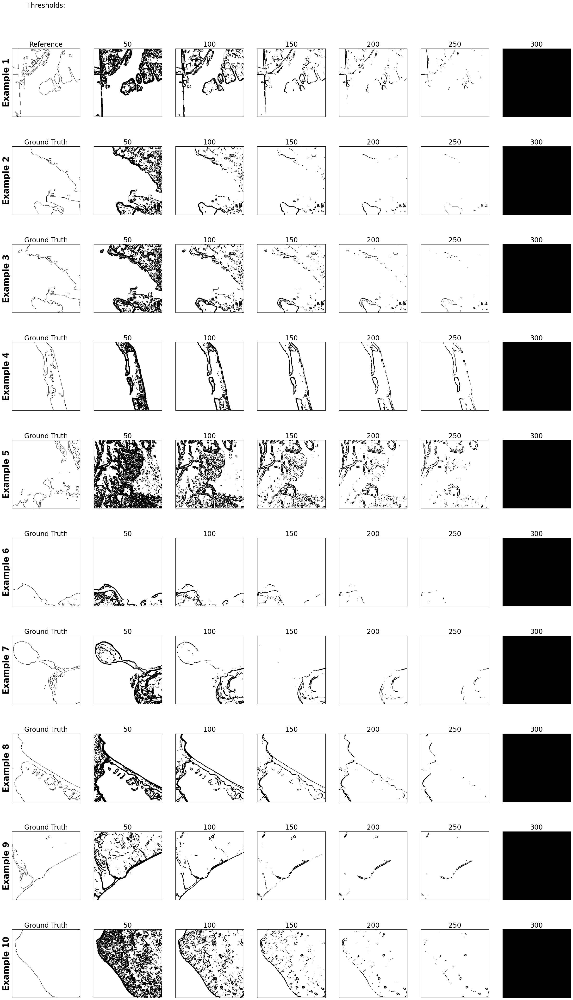

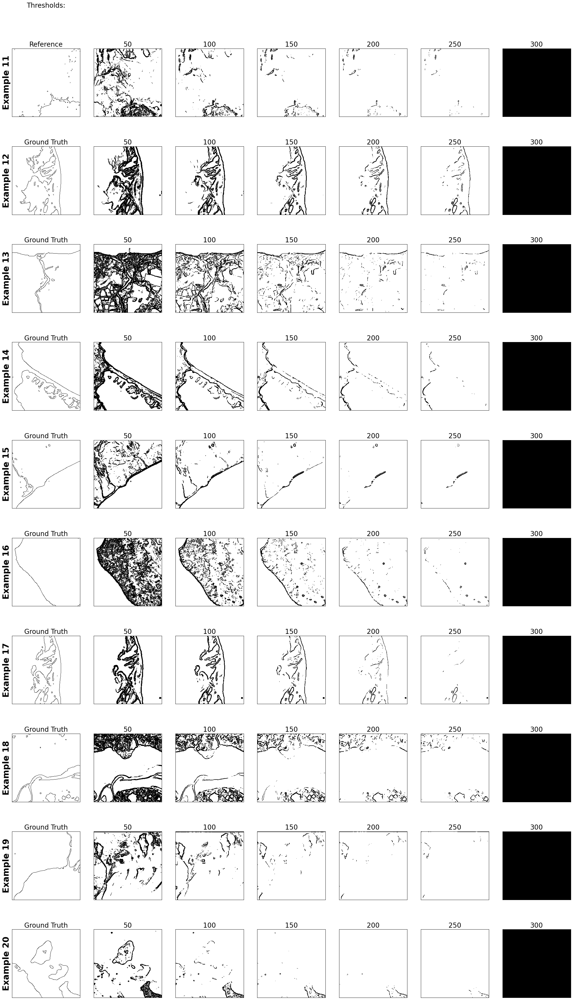

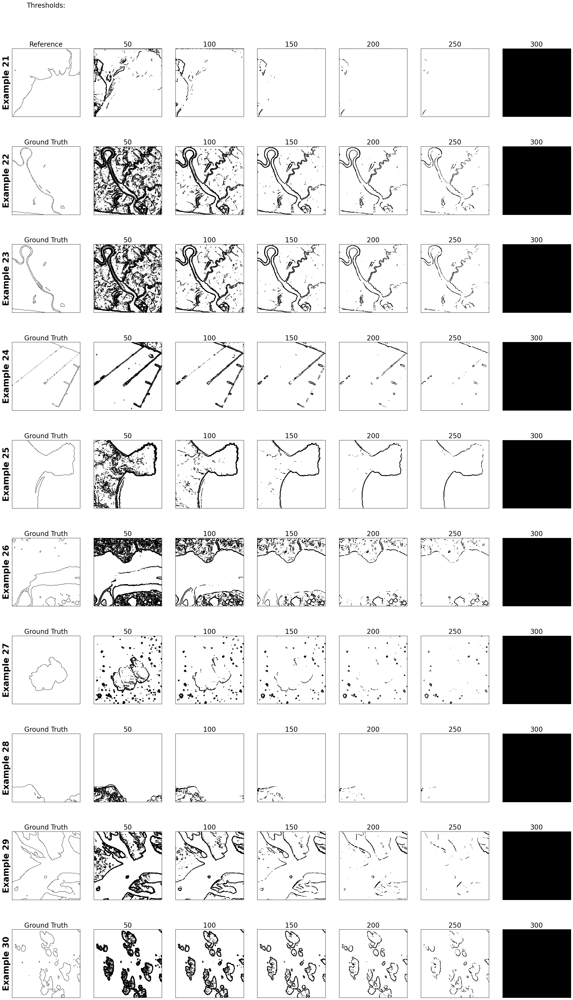

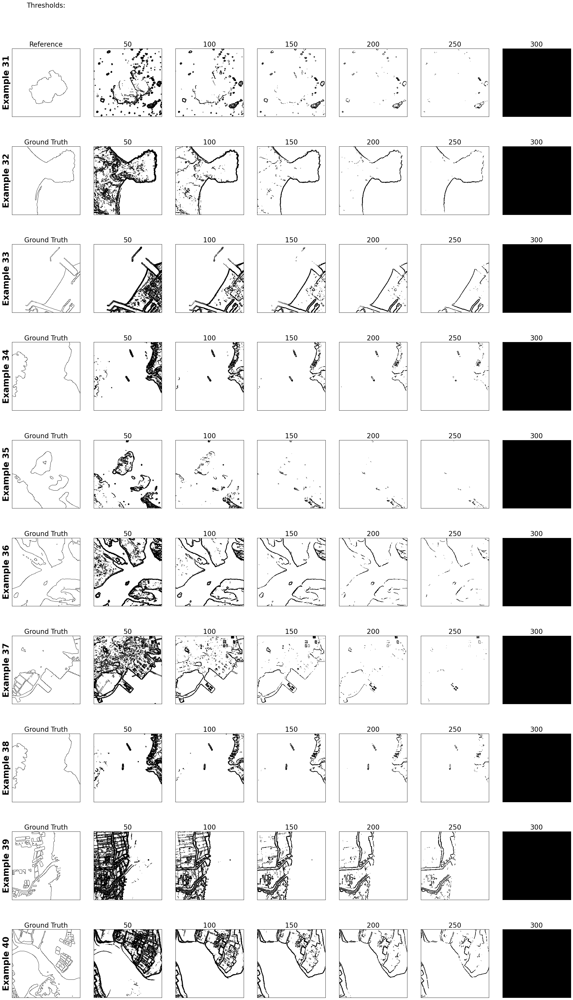

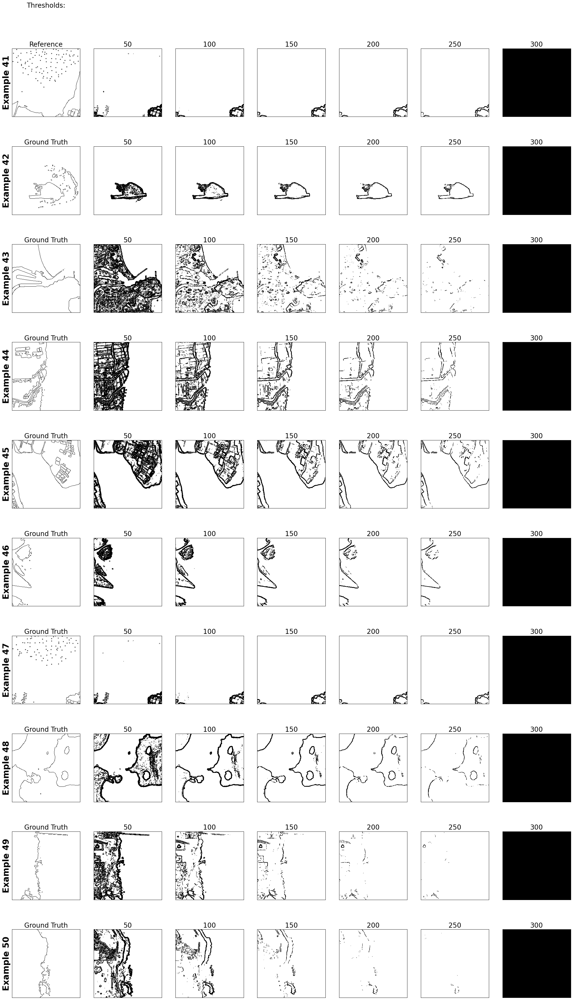

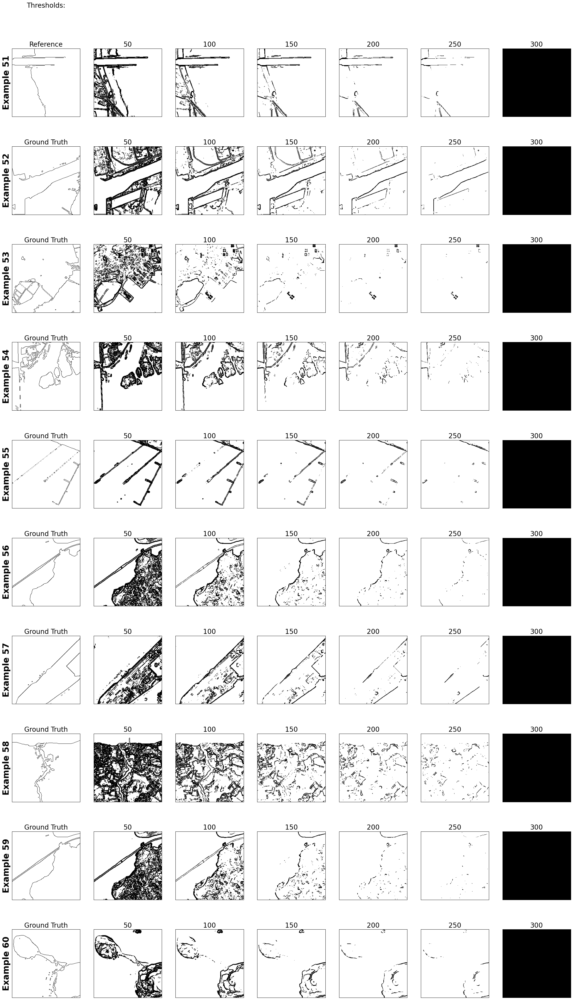

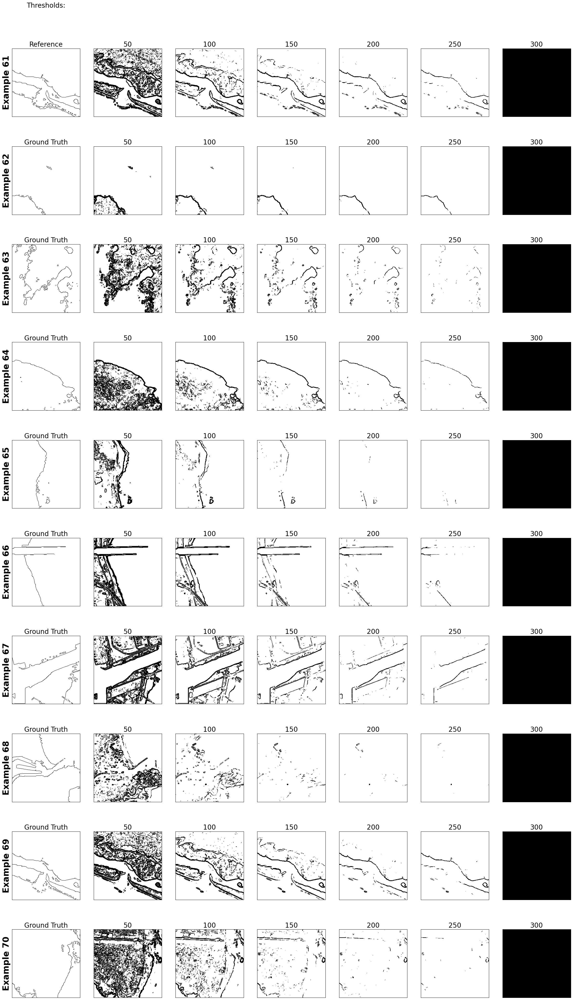

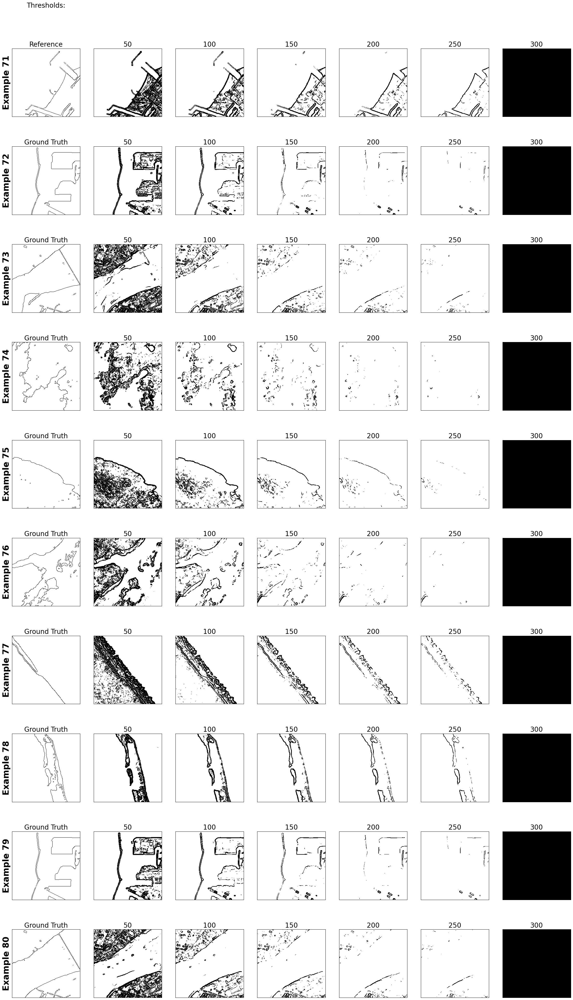

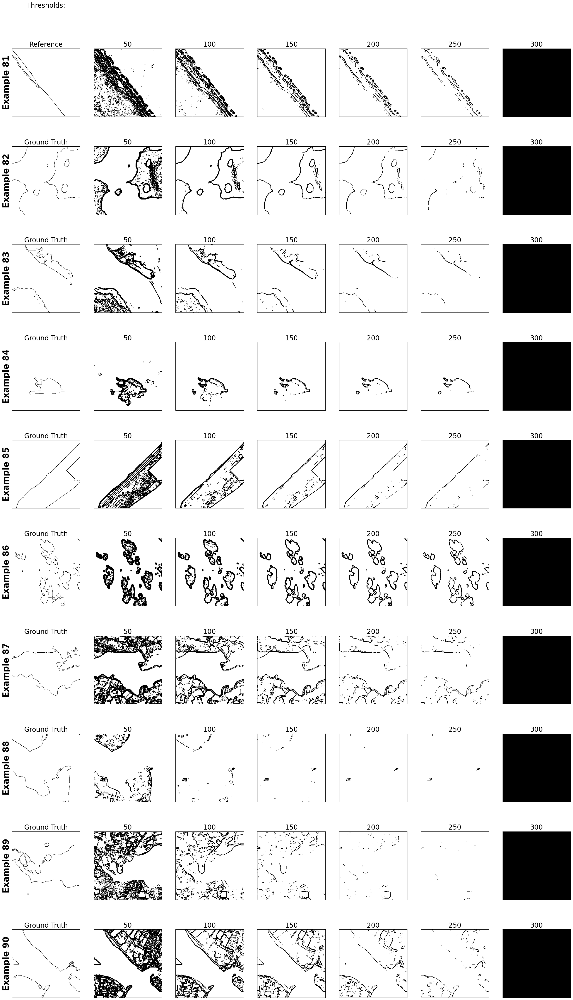

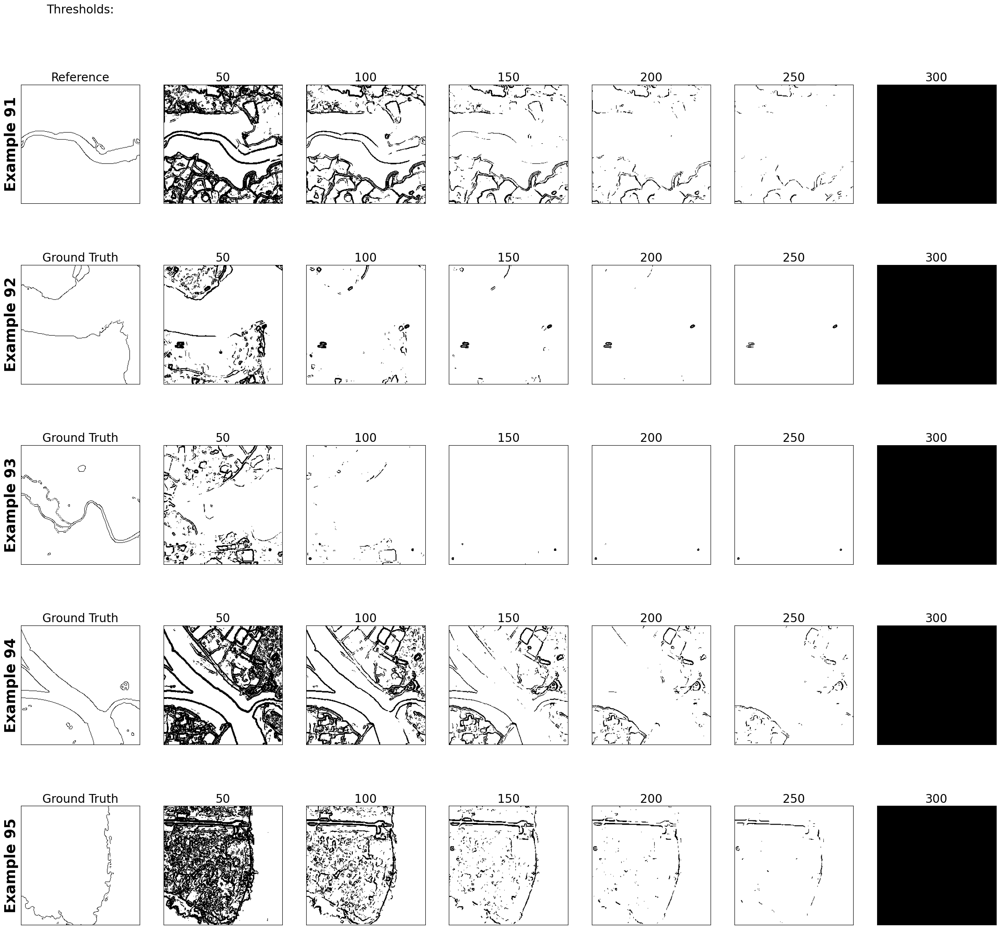

In [40]:
# --- Get image names from filtered test set (after removing bad ones) ---
x = [path.split("/")[-1] for path in test_paths_2]  # Use test_paths_2, not original test_path
df = pd.DataFrame({"ID": x})
df.to_clipboard(index=False)  # Copy image file names for manual inspection

# --- Group image IDs for visual inspection ---
ALL_IDS = [
    list(range(0, 10)), list(range(10, 20)), list(range(20, 30)),
    list(range(30, 40)), list(range(40, 50)), list(range(50, 60)),
    list(range(60, 70)), list(range(70, 80)), list(range(80, 90)),
    list(range(90, len(test_paths_2)))
]

# --- Generate Sobel example plots (no metrics) ---
for i, IDs in enumerate(ALL_IDS):
    viz_sobel.example_plots(IDs, ex_diff=10 * i, show_metrics=False,
                            save_path=save_path + f"\\Figures\\sobel_group_{i+1}.png")